In [ ]:
'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/healthyfime_tfkeras.csv'

'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/healthyfime_tfkeras.csv'

In [ ]:
'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/multiclass.csv'

'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/multiclass.csv'

In [ ]:
'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/spiral.csv'

'/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/spiral.csv'

In [ ]:
import tensorflow as tf

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/healthyfime_tfkeras.csv')
df

,age,gender,height_cm,weight_kg,body fat_%,diastolic,systolic,gripForce,sit and bend forward_cm,sit-ups counts,broad jump_cm,class
0,27.0,M,172.3,75.24,21.3,80.0,130.0,54.9,18.4,60.0,217.0,C
1,25.0,M,165.0,55.80,15.7,77.0,126.0,36.4,16.3,53.0,229.0,A
2,31.0,M,179.6,78.00,20.1,92.0,152.0,44.8,12.0,49.0,181.0,C
3,32.0,M,174.5,71.10,18.4,76.0,147.0,41.4,15.2,53.0,219.0,B
4,28.0,M,173.8,67.70,17.1,70.0,127.0,43.5,27.1,45.0,217.0,B
...,...,...,...,...,...,...,...,...,...,...,...,...
13388,25.0,M,172.1,71.80,16.2,74.0,141.0,35.8,17.4,47.0,198.0,C
13389,21.0,M,179.7,63.90,12.1,74.0,128.0,33.0,1.1,48.0,167.0,D
13390,39.0,M,177.2,80.50,20.1,78.0,132.0,63.5,16.4,45.0,229.0,A
13391,64.0,F,146.1,57.70,40.4,68.0,121.0,19.3,9.2,0.0,75.0,D


In [ ]:
df.replace({"M":0, "F":1} , inplace = True)
df.head()

classes = list(df['class'].unique())
mapping_dict = { ch : i for i, ch in enumerate(sorted(classes, reverse=True)) }
print (mapping_dict)

{'D': 0, 'C': 1, 'B': 2, 'A': 3}


In [ ]:

X, y = df.iloc[:, :-1], df.iloc[:, -1]
print(X.shape, y.shape)

from sklearn.model_selection import train_test_split

X_dev, X_test, y_dev, y_test = train_test_split(X, y, test_size=0.1, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_dev, y_dev, test_size=0.1, random_state=42)

print('Train : ', X_train.shape, y_train.shape)
print('Valid : ', X_val.shape, y_val.shape)
print('Test  : ', X_test.shape, y_test.shape)



(13393, 11) (13393,)
Train :  (10847, 11) (10847,)
Valid :  (1206, 11) (1206,)
Test  :  (1340, 11) (1340,)


In [ ]:

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

model = Sequential([
    
    Dense(100, activation = "relu", input_shape=(11,)),
    Dense(4, activation = "softmax")
    
])


model.summary()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 100)               1200      
                                                                 
 dense_3 (Dense)             (None, 4)                 404       
                                                                 
Total params: 1,604
Trainable params: 1,604
Non-trainable params: 0
_________________________________________________________________


In [ ]:




model = Sequential()


model.add(
        Dense(32,
        activation= "elu",
        input_shape = (11,),
        name = "hidden_1"  ,
        kernel_initializer = 'glorot_uniform',
        bias_initializer = "ones"
        ))
model.add(
        Dense(64,
        activation= "elu",
        name = "hidden_2"  ,
        kernel_initializer = 'glorot_uniform',
        bias_initializer = "ones"
        ))

model.add(
        Dense(128,
        activation= "elu",
        name = "hidden_3"  ,
        kernel_initializer = 'glorot_uniform',
        bias_initializer = "ones"
        ))
model.add(
        Dense(64,
        activation= "elu",
        name = "hidden_4"  ,
        kernel_initializer = 'glorot_uniform',
        bias_initializer = "ones"
        ))
model.add(
        Dense(32,
        activation= "elu",
        name = "hidden_5"  ,
        kernel_initializer = 'glorot_uniform',
        bias_initializer = "ones"
        ))

model.add(
        Dense(4,
        activation= "softmax",
        name = "Output"  ,
        kernel_initializer = "glorot_uniform",
        bias_initializer = "ones"
        ))




print()
print()

for p in model.weights:
    print(p.shape)
    
print()
print()
print()
model.summary()




(11, 32)
(32,)
(32, 64)
(64,)
(64, 128)
(128,)
(128, 64)
(64,)
(64, 32)
(32,)
(32, 4)
(4,)



Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 hidden_1 (Dense)            (None, 32)                384       
                                                                 
 hidden_2 (Dense)            (None, 64)                2112      
                                                                 
 hidden_3 (Dense)            (None, 128)               8320      
                                                                 
 hidden_4 (Dense)            (None, 64)                8256      
                                                                 
 hidden_5 (Dense)            (None, 32)                2080      
                                                                 
 Output (Dense)              (None, 4)                 132       
                        

In [ ]:
# get the weights from the layers
weight_layers = [layer for layer in model.layers]
weight_layers

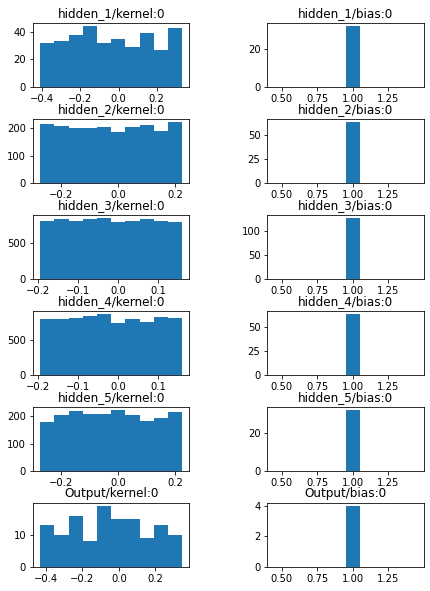

In [ ]:



# Plot histograms of weight and bias values
import matplotlib.pyplot as plt
fig, axes = plt.subplots(6, 2, figsize=(7,10))
fig.subplots_adjust(hspace=0.5, wspace=0.5)


for i, layer in enumerate(weight_layers):
    for j in [0, 1]:
        axes[i, j].hist(layer.weights[j].numpy().flatten(), align='left')
        axes[i, j].set_title(layer.weights[j].name)


In [ ]:



model.compile(
    optimizer='adam',
    loss= 'CategoricalCrossentropy',
    metrics=['Accuracy','Precision','Recall']
    )


In [ ]:


y_train = pd.get_dummies(y_train).to_numpy()
y_val = pd.get_dummies(y_val).to_numpy()
y_test = pd.get_dummies(y_test).to_numpy()


In [ ]:


history  = model.fit(X_train,
                    y_train,
                    batch_size=128,
                    epochs= 300,
                    verbose= 0,
                    validation_split=0.1
                   )

In [ ]:
epochs = history.epoch
loss = history.history["loss"]
Accuracy = history.history["Accuracy"]
precision = history.history["precision"]
recall = history.history["recall"]

val_loss = history.history["val_loss"]
val_Accuracy = history.history["val_Accuracy"]
val_precision = history.history["val_precision"]
val_recall = history.history["val_recall"]

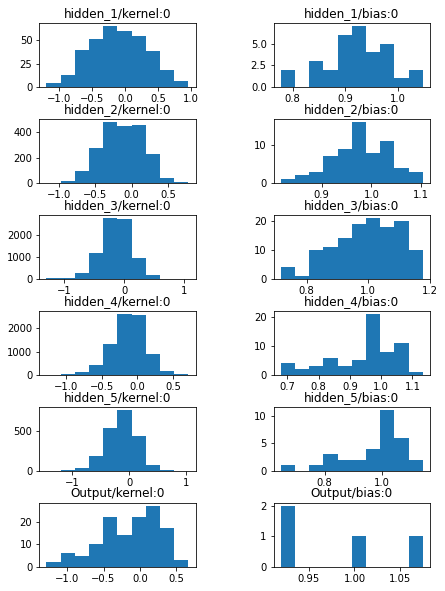

In [ ]:
# Plot histograms of weight and bias values after training
import matplotlib.pyplot as plt
fig, axes = plt.subplots(6, 2, figsize=(7,10))
fig.subplots_adjust(hspace=0.5, wspace=0.5)

# get the weights from the layers
weight_layers = [layer for layer in model.layers]

for i, layer in enumerate(weight_layers):
    for j in [0, 1]:
        axes[i, j].hist(layer.weights[j].numpy().flatten(), align='left')
        axes[i, j].set_title(layer.weights[j].name)



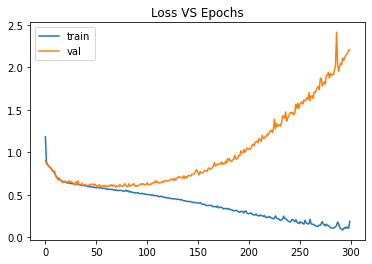

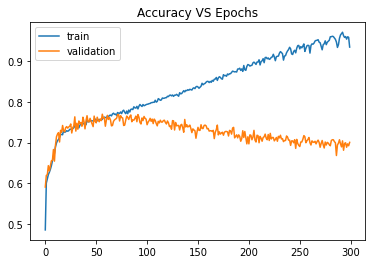

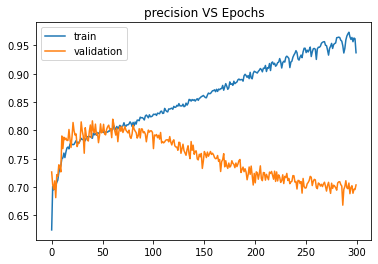

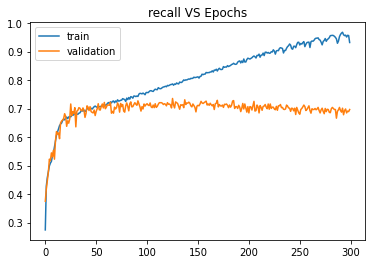

In [ ]:







plt.figure()
plt.plot(epochs, loss, label="train")
plt.plot(epochs, val_loss, label="val")
plt.legend()
plt.title("Loss VS Epochs")
plt.show()

plt.figure()
plt.plot(epochs, Accuracy, label="train")
plt.plot(epochs, val_Accuracy, label="validation")
plt.legend()
plt.title("Accuracy VS Epochs")
plt.show()

plt.figure()
plt.plot(epochs, precision, label="train")
plt.plot(epochs, val_precision, label="validation")
plt.legend()
plt.title("precision VS Epochs")
plt.show()

plt.figure()
plt.plot(epochs, recall, label="train")
plt.plot(epochs, val_recall, label="validation")
plt.legend()
plt.title("recall VS Epochs")
plt.show()





In [ ]:
model.evaluate(X_val,y_val)

38/38 [==============================] - 0s 3ms/step - loss: 2.2324 - Accuracy: 0.7056 - precision: 0.7048 - recall: 0.6990


[2.2323853969573975,
 0.7056384682655334,
 0.7048494815826416,
 0.6990049481391907]

In [ ]:
model.evaluate(X_test,y_test)

42/42 [==============================] - 0s 2ms/step - loss: 2.2137 - Accuracy: 0.6978 - precision: 0.7003 - recall: 0.6940


[2.2137234210968018,
 0.6977611780166626,
 0.7003012299537659,
 0.6940298676490784]

In [ ]:
def create_model():
    
    model = Sequential([
        
        Dense(32,activation="relu",input_shape=(11,),name="H1"),
        Dense(16,activation="relu",name="H2"),
        Dense(4,activation="softmax",name="output"),
        
    ])
    
    model.compile(
        
        optimizer= tf.keras.optimizers.Adam(learning_rate=0.001),
        loss= tf.keras.losses.categorical_crossentropy,
        metrics=['Accuracy',tf.keras.metrics.Precision()]
        
    )
    
    return model


In [ ]:
model = create_model()

In [ ]:
from tensorflow.keras.callbacks import TensorBoard
log_dir = "logs/fit/"

Board = TensorBoard(log_dir = log_dir, 
                    histogram_freq = 1)

In [ ]:
# import kera
class VerbosCallback(tf.keras.callbacks.Callback):
    

    def on_epoch_end(self, epoch, logs=None):
      
      if epoch % 50 == 0:
        print(f"Epoch:{str(epoch).zfill(3)}, Loss:{logs['loss']}")
    

In [ ]:
# obj = VerbosCallback(n_epochs=25)

In [ ]:
# from keras.api._v2.keras import callbacks

history = model.fit(x = X_train,
                    y = y_train , 
                    epochs = 500,
                    batch_size = 256,
                    validation_split = 0.1,
                    verbose = 0,
                    callbacks = [VerbosCallback(),Board])

Epoch:000, Loss:0.5350478887557983
Epoch:050, Loss:0.5327823162078857
Epoch:100, Loss:0.5333772301673889
Epoch:150, Loss:0.5299826860427856
Epoch:200, Loss:0.5290886759757996
Epoch:250, Loss:0.52790367603302
Epoch:300, Loss:0.5259743332862854
Epoch:350, Loss:0.525821328163147
Epoch:400, Loss:0.5254995226860046
Epoch:450, Loss:0.522682785987854


In [ ]:
model.evaluate(X_test,y_test)

42/42 [==============================] - 0s 2ms/step - loss: 0.5894 - Accuracy: 0.7560 - precision_2: 0.7901


[0.58939129114151, 0.7559701204299927, 0.7901134490966797]

In [ ]:
%load_ext tensorboard

%tensorboard --logdir={log_dir}

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
epochs = history.epoch
loss = history.history["loss"]
Accuracy = history.history["Accuracy"]


val_loss = history.history["val_loss"]
val_Accuracy = history.history["val_Accuracy"]


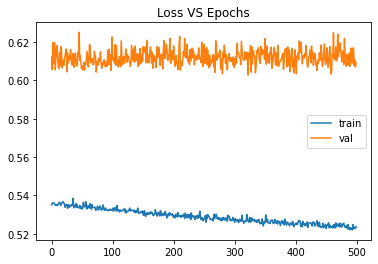

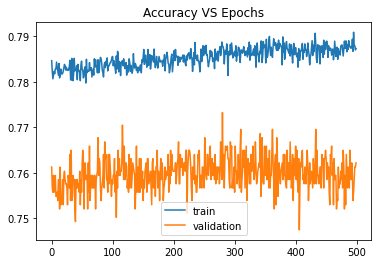

In [ ]:







plt.figure()
plt.plot(epochs, loss, label="train")
plt.plot(epochs, val_loss, label="val")
plt.legend()
plt.title("Loss VS Epochs")
plt.show()

plt.figure()
plt.plot(epochs, Accuracy, label="train")
plt.plot(epochs, val_Accuracy, label="validation")
plt.legend()
plt.title("Accuracy VS Epochs")
plt.show()


In [ ]:
def exponential_smoothing(series, alpha):
    """given a series and alpha, return series of expoentially smoothed points"""
    results = np.zeros_like(series)

    # first value remains the same as series,
    # as there is no history to learn from
    results[0] = series[0] 
    for t in range(1, series.shape[0]):
        results[t] = alpha * series[t] + (1 - alpha) * results[t - 1]

    return results

In [ ]:
import numpy as np
np.random.randint(0,5,100)

array([1, 1, 3, 3, 1, 4, 2, 2, 2, 1, 4, 0, 1, 3, 2, 1, 4, 1, 2, 2, 2, 0,
       3, 4, 2, 4, 1, 0, 4, 0, 4, 0, 2, 0, 4, 1, 1, 4, 0, 4, 3, 4, 0, 1,
       2, 1, 0, 1, 2, 1, 0, 0, 0, 4, 0, 4, 1, 1, 0, 2, 0, 1, 4, 3, 0, 0,
       2, 3, 2, 4, 1, 0, 3, 1, 4, 0, 4, 2, 2, 3, 0, 4, 4, 2, 1, 3, 0, 2,
       0, 1, 1, 2, 1, 3, 4, 4, 1, 2, 4, 2])

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


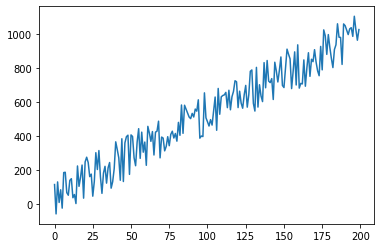

In [ ]:

X = pd.Series(np.linspace(50,1000,200) + np.random.randint(-140,140,200))


plt.plot(X)

In [ ]:
import statsmodels.api  as sm
import warnings
warnings.filterwarnings("ignore")

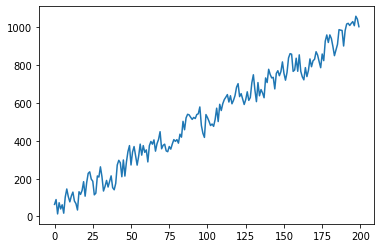

In [ ]:

model = sm.tsa.SimpleExpSmoothing(X.values)
_= model.fit(smoothing_level=0.51)
plt.plot(_.fittedvalues)

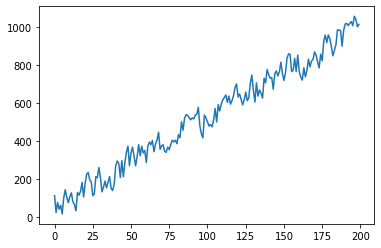

In [ ]:
plt.plot(exponential_smoothing(X.values,0.51))

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/multiclass.csv')

In [ ]:
df.shape

(440, 8)

In [ ]:
df.head()

,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen,class
0,3,12669,9656,7561,214,2674,1338,2
1,3,7057,9810,9568,1762,3293,1776,2
2,3,6353,8808,7684,2405,3516,7844,2
3,3,13265,1196,4221,6404,507,1788,1
4,3,22615,5410,7198,3915,1777,5185,1


In [ ]:

X, y = df.iloc[:, :-1], df.iloc[:, -1]
print(X.shape, y.shape)

(440, 7) (440,)


array([[0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       ...,
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0]], dtype=uint8)

In [ ]:
from sklearn.datasets import make_regression


In [ ]:
X,y = make_regression(n_samples=1000, 
                    n_features=15,n_informative=8,

                    )

In [ ]:


from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)


print('Train : ', X_train.shape, y_train.shape)
print('Test  : ', X_test.shape, y_test.shape)



Train :  (900, 15) (900,)
Test  :  (100, 15) (100,)


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_percentage_error,r2_score
RFR = RandomForestRegressor(n_estimators=1000,max_depth=10)
RFR.fit(X_train,y_train)
r2_score(y_test, RFR.predict(X_test)),r2_score(y_train, RFR.predict(X_train))

(0.7793524934900717, 0.971572521748643)

In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((900, 15), (100, 15), (900,), (100,))

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

In [ ]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense

In [ ]:
from tensorflow.keras.callbacks import TensorBoard
import datetime

tb_callback = TensorBoard(log_dir='logs',histogram_freq=1)

In [ ]:
from keras.api._v2.keras import callbacks
from tensorflow.python import metrics
def create_baseline():

    

    model = Sequential([
                    Dense(15, activation="relu",input_shape = (15,),
                              kernel_initializer='glorot_uniform',
                              kernel_regularizer =  tf.keras.regularizers.L2(l2=0.001)),
                    Dense(16, activation="relu",kernel_initializer='glorot_uniform',
                          kernel_regularizer =  tf.keras.regularizers.L2(l2=0.001)),
                    Dense(8, activation="relu",kernel_initializer='glorot_uniform',
                          kernel_regularizer =  tf.keras.regularizers.L2(l2=0.001)),
                 
                 
                    Dense(1)])  
    return model
model = create_baseline()

# MiniBatch Gradient Descnet as Optimizer 

model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = tf.keras.losses.MSE,
    metrics = tf.keras.metrics.mean_absolute_percentage_error,
    
)

history = model.fit(x=X_train,
                    y=y_train,
                    validation_split = 0.1,
                    epochs=500,
                    batch_size=32,
                    verbose = 0,
                    callbacks = [tb_callback])


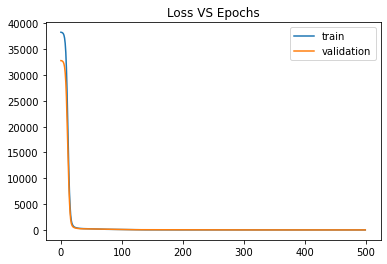

In [ ]:
epochs = history.epoch
loss = history.history["loss"]
val_loss = history.history["val_loss"]
mean_absolute_percentage_error = history.history["mean_absolute_percentage_error"]
val_mean_absolute_percentage_error = history.history["val_mean_absolute_percentage_error"]

import matplotlib.pyplot as plt

plt.plot(epochs, loss, label="train")
plt.plot(epochs, val_loss, label="validation")

plt.legend()
plt.title("Loss VS Epochs")

plt.show()
  

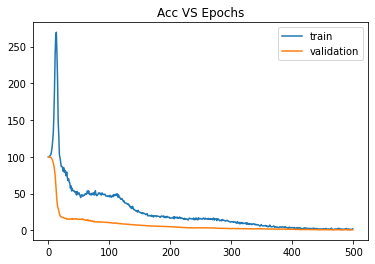

In [ ]:
plt.plot(epochs, mean_absolute_percentage_error, label="train")
plt.plot(epochs, val_mean_absolute_percentage_error, label="validation")

plt.legend()
plt.title("Acc VS Epochs")

plt.show()
  

In [ ]:
model.evaluate(X_test,y_test)

4/4 [==============================] - 0s 6ms/step - loss: 1425.7456 - mean_absolute_percentage_error: 60.3230


[1425.74560546875, 60.32303237915039]

In [ ]:
%load_ext tensorboard

%tensorboard --logdir={'logs'}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 55822), started 0:05:12 ago. (Use '!kill 55822' to kill it.)

<IPython.core.display.Javascript object>

        
        currenct
        gradient
        momentum

        Vdw =   beta * VdW(k-1) * (1-beta)*dWk
                       previous momentum

                baeta is SES parameter
                weight to the previous value


      

        SGD
        stockastic gradient descnet
        provide momentum 
        exponential smoothing of GD

        RMSProp
        learning rate is adjusted 
        so , if the gradient is too large, 
        the relatively learning rate becomes small and adjusts . 
        and make the reasonable update for the next epoch.
        if gradient is too small , 
        the relative LR becomes large and make resonable adjustment.s

        Adam: 
        adam is kind of both 
        of SGD and RMSProp 

        also takes momentum ,
        and inversely proportional LR to gradient. 
        makes 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [10]:
import pandas as pd
import time

In [11]:
%%time

df = pd.read_csv('/content/drive/Othercomputers/My Laptop/Data Science Studies/GitHub_Desktop/Neural Networks/Fraud.csv')

CPU times: user 13.2 s, sys: 3.1 s, total: 16.3 s
Wall time: 18.7 s


In [4]:
df

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,1,PAYMENT,9839.64,C1231006815,170136.00,160296.36,M1979787155,0.00,0.00,0,0
1,1,PAYMENT,1864.28,C1666544295,21249.00,19384.72,M2044282225,0.00,0.00,0,0
2,1,TRANSFER,181.00,C1305486145,181.00,0.00,C553264065,0.00,0.00,1,0
3,1,CASH_OUT,181.00,C840083671,181.00,0.00,C38997010,21182.00,0.00,1,0
4,1,PAYMENT,11668.14,C2048537720,41554.00,29885.86,M1230701703,0.00,0.00,0,0
...,...,...,...,...,...,...,...,...,...,...,...
6362615,743,CASH_OUT,339682.13,C786484425,339682.13,0.00,C776919290,0.00,339682.13,1,0
6362616,743,TRANSFER,6311409.28,C1529008245,6311409.28,0.00,C1881841831,0.00,0.00,1,0
6362617,743,CASH_OUT,6311409.28,C1162922333,6311409.28,0.00,C1365125890,68488.84,6379898.11,1,0
6362618,743,TRANSFER,850002.52,C1685995037,850002.52,0.00,C2080388513,0.00,0.00,1,0
